# Content
1. <a href="#scrollTo=0vzQ6V2Hhl9D" style="color: blue;">Overall</a>
2. <a href="#scrollTo=6trIY2BEhwBE" style="color: blue;">FPT</a>
3. <a href="#scrollTo=pKvL7K43h-pj" style="color: blue;">MSN</a>
4. <a href="#scrollTo=VFz-HZrbiKL7" style="color: blue;">PNJ</a>
5. <a href="#scrollTo=rPkSEzmQiLuW" style="color: blue;">VIC</a>

In [21]:
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from datetime import timedelta
from xgboost import XGBRegressor, plot_importance
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
plt.style.use("fivethirtyeight")
%matplotlib inline

In [22]:
from google.colab import drive
drive.mount('/content/drive')
root_folder = '/content/drive/MyDrive/Colab Notebooks/Entry_Test/'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Overall

In [23]:
ticker_names = ['FPT', 'MSN', 'PNJ', 'VIC']
ticker_dict = {}
for file_name in ticker_names:
    path = f"{root_folder}{file_name}.csv"
    ticker = pd.read_csv(path)
    ticker['Date/Time'] = pd.to_datetime(ticker['Date/Time'])
    ticker.index = ticker['Date/Time']
    ticker = ticker.drop(['Date/Time'], axis=1)
    # ticker['Fluctuation'] = ticker['Close'] - ticker['Open']
    ticker_dict[file_name] = ticker
df = pd.DataFrame()
for ticker in ticker_dict:
    df = pd.concat([df, ticker_dict[ticker]])

In [24]:
df.head()

,Ticker,Open,High,Low,Close,Volume,Open Interest
Date/Time,,,,,,,
2018-12-25 09:15:00,FPT,30.89,30.89,30.89,30.89,35410,0
2018-12-25 09:16:00,FPT,30.81,30.81,30.81,30.81,190,0
2018-12-25 09:17:00,FPT,30.74,30.81,30.74,30.74,1120,0
2018-12-25 09:18:00,FPT,30.74,30.74,30.74,30.74,2120,0
2018-12-25 09:19:00,FPT,30.74,30.74,30.74,30.74,22500,0


In [25]:
df.describe()

,Open,High,Low,Close,Volume,Open Interest
count,459335.000000,459335.000000,459335.000000,459335.000000,4.593350e+05,459335.0
mean,74.545826,74.626579,74.481065,74.546183,4.909390e+03,0.0
std,23.023346,23.038201,23.011619,23.024380,1.902104e+04,0.0
min,30.250000,30.250000,30.220000,30.250000,1.000000e+00,0.0
25%,54.190000,54.250000,54.150000,54.190000,3.600000e+02,0.0
50%,75.730000,75.920000,75.600000,75.720000,1.500000e+03,0.0
75%,90.100000,90.200000,90.000000,90.100000,4.920000e+03,0.0
max,126.100000,126.500000,126.100000,126.500000,3.300680e+06,0.0


**Thuộc tính `Open Interest` không có giá trị khác ngoài "$0$", nên  ta sẽ bỏ thuộc tính này.**

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 459335 entries, 2018-12-25 09:15:00 to 2020-12-22 14:46:00
Data columns (total 7 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Ticker         459335 non-null  object 
 1   Open           459335 non-null  float64
 2   High           459335 non-null  float64
 3   Low            459335 non-null  float64
 4   Close          459335 non-null  float64
 5   Volume         459335 non-null  int64  
 6   Open Interest  459335 non-null  int64  
dtypes: float64(4), int64(2), object(1)
memory usage: 28.0+ MB


In [50]:
def line_chart(col, ticker_list):
    plt.figure(figsize=(15, 10))
    plt.subplots_adjust(top=1.25, bottom=1.2)
    for i in range(len(ticker_list)):
        ticker = ticker_list[i]
        plt.subplot(2, 2, i+1)
        df[df['Ticker']== ticker][col].plot()
        plt.ylabel(col)
        plt.xlabel(None)
        plt.title(f"{col} Price of {ticker}")
    plt.tight_layout()

def prediction_plot(ticker_df, y_col, test_size=0.15, valid_size = 0.15):
    test_split_idx  = int(len(ticker_df) * (1-test_size))
    predicted_prices = ticker_df.iloc[test_split_idx+1:].copy()
    predicted_prices[y_col] = y_pred
    fig = make_subplots(rows=2, cols=1)
    fig.add_trace(go.Scatter(x=ticker_df.index, y=ticker_df[y_col],
                            name='Truth', marker_color='LightSkyBlue'),
                  row=1, col=1)

    fig.add_trace(go.Scatter(x=predicted_prices.index,
                             y=predicted_prices[y_col],
                             name='Prediction', marker_color='MediumPurple'),
                  row=1, col=1)
    fig.add_trace(go.Scatter(x=predicted_prices.index,
                             y=y_test, name='Truth',
                             marker_color='LightSkyBlue', showlegend=False),
                  row=2, col=1)
    fig.add_trace(go.Scatter(x=predicted_prices.index,
                             y=y_pred, name='Prediction',
                             marker_color='MediumPurple',
                             showlegend=False),
                  row=2, col=1)
    fig.show()

def plot_dataset(train, val, test, col):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=train.index, y=train[col], name='Training'))
    fig.add_trace(go.Scatter(x=val.index, y=val[col], name='Validation'))
    fig.add_trace(go.Scatter(x=test.index,  y=test[col],  name='Test'))
    fig.show()

In [ ]:
# line_chart('Fluctuation',ticker_names)
line_chart('Close', ticker_names)

In [29]:
def train_test_split(ticker_df, test_size  = 0.15, valid_size = 0.15):
    test_split_idx  = int(len(ticker_df) * (1-test_size))
    valid_split_idx = int(len(ticker_df) * (1-(valid_size+test_size)))
    train_df  = ticker_df.iloc[:valid_split_idx].copy()
    valid_df  = ticker_df.iloc[valid_split_idx+1:test_split_idx].copy()
    test_df   = ticker_df.iloc[test_split_idx+1:].copy()
    return train_df, valid_df, test_df

def drop(ticker_df, cols=None, frows=None):
    if cols:
        ticker_df = ticker_df.drop(cols, axis=1)
    elif frows:
        ticker_df = ticker_df.tail(-frows)
    return ticker_df

def xy_split(train, valid, test, y_col):
    y_train = train[y_col].copy()
    X_train = train.drop([y_col], axis=1)

    y_valid = valid[y_col].copy()
    X_valid = valid.drop([y_col], axis=1)

    y_test  = test[y_col].copy()
    X_test  = test.drop([y_col], axis=1)
    return y_train, X_train, y_valid, X_valid, y_test, X_test

## Các Chỉ Số Hỗ Trợ Dự Đoán
- Moving Average `MA`
- Simple Moving Average `SMA`
- Exponential Moving Average `EMA`
- Moving Average Convergence Divergence `MACD`
- Relative Strength Index `RSI`



In [30]:
def calc_MA(ticker_df, time_dict):
    for unit in time_dict:
        for ma in time_dict[unit]:
            column_name = f"MA{ma}_" + unit
            if unit == 'minutes':
                time_i = timedelta(minutes=ma)
            elif unit == 'hours':
                time_i = timedelta(hours=ma)
            elif unit == 'days':
                time_i = timedelta(days=ma)
            ticker_df[column_name] = ticker_df['Close'].rolling(time_i).mean()


def calc_SMA(ticker_df, time_dict):
    for unit in time_dict:
        for sma in time_dict[unit]:
            column_name = f"SMA{sma}_" + unit
            if unit == 'minutes':
                time_i = timedelta(minutes=sma)
            elif unit == 'hours':
                time_i = timedelta(hours=sma)
            elif unit == 'days':
                time_i = timedelta(days=sma)
            ticker_df[column_name] = ticker_df['Close'].rolling(time_i).mean().shift()


def calc_EMA(ticker_df, time_dict):
    for unit in time_dict:
        for ema in time_dict['days']:
            column_name = f"EMA{ema}"
            ticker_df[column_name] = ticker_df['Close'].ewm(ema).mean().shift()


def calc_RSI(ticker_df, days=14):
    close = ticker_df['Close']
    delta = close.diff()
    delta = delta[1:]
    pricesUp = delta.copy()
    pricesDown = delta.copy()
    pricesUp[pricesUp < 0] = 0
    pricesDown[pricesDown > 0] = 0
    rollUp = pricesUp.rolling(days).mean()
    rollDown = pricesDown.abs().rolling(days).mean()
    rs = rollUp / rollDown
    rsi = 100.0 - (100.0 / (1.0 + rs))
    ticker_df['RSI'] = rsi.fillna(0)

def calc_MACD(ticker_df):
    EMA_12 = pd.Series(ticker_df['Close'].ewm(span=12, min_periods=12).mean())
    EMA_26 = pd.Series(ticker_df['Close'].ewm(span=26, min_periods=26).mean())
    ticker_df['MACD'] = pd.Series(EMA_12 - EMA_26)
    ticker_df['MACD_signal'] = pd.Series(ticker_df.MACD.ewm(span=9, min_periods=9).mean())

* * *
# FPT

In [31]:
time_dict = {'minutes':[5, 15, 30], 'hours':[1, 6, 12], 'days':[1, 10, 15, 30]}
FPT_ticker = ticker_dict['FPT'].copy()
calc_MA(FPT_ticker, time_dict)
calc_SMA(FPT_ticker, time_dict)
calc_EMA(FPT_ticker, time_dict)
calc_RSI(FPT_ticker)
calc_MACD(FPT_ticker)
FPT_ticker.columns

Index(['Ticker', 'Open', 'High', 'Low', 'Close', 'Volume', 'Open Interest',
       'MA5_minutes', 'MA15_minutes', 'MA30_minutes', 'MA1_hours', 'MA6_hours',
       'MA12_hours', 'MA1_days', 'MA10_days', 'MA15_days', 'MA30_days',
       'SMA5_minutes', 'SMA15_minutes', 'SMA30_minutes', 'SMA1_hours',
       'SMA6_hours', 'SMA12_hours', 'SMA1_days', 'SMA10_days', 'SMA15_days',
       'SMA30_days', 'EMA1', 'EMA10', 'EMA15', 'EMA30', 'RSI', 'MACD',
       'MACD_signal'],
      dtype='object')

Chúng ta sẽ sử dụng `Feature` của thời điểm $time_i$ dự đoán cho thời điểm $time_{i+1}$

In [32]:
# FPT_ticker['Fluctuation'] = FPT_ticker['Fluctuation'].shift(-1)
FPT_ticker['Close'] = FPT_ticker['Close'].shift(-1)
# drop_cols = ['Close', 'Open', 'Low', 'High', 'Open Interest', 'Ticker']
FPT_ticker = drop(FPT_ticker, cols=['Open', 'Low', 'High', 'Open Interest', 'Ticker'], frows=3300)
FPT_ticker = FPT_ticker[:-1]
FPT_ticker.columns

Index(['Close', 'Volume', 'MA5_minutes', 'MA15_minutes', 'MA30_minutes',
       'MA1_hours', 'MA6_hours', 'MA12_hours', 'MA1_days', 'MA10_days',
       'MA15_days', 'MA30_days', 'SMA5_minutes', 'SMA15_minutes',
       'SMA30_minutes', 'SMA1_hours', 'SMA6_hours', 'SMA12_hours', 'SMA1_days',
       'SMA10_days', 'SMA15_days', 'SMA30_days', 'EMA1', 'EMA10', 'EMA15',
       'EMA30', 'RSI', 'MACD', 'MACD_signal'],
      dtype='object')

In [ ]:
FPT_train, FPT_valid, FPT_test = train_test_split(FPT_ticker)
# plot_dataset(FPT_train, FPT_valid, FPT_test, col='Fluctuation')
plot_dataset(FPT_train, FPT_valid, FPT_test, col='Close')

In [34]:
# y_train, X_train, y_valid, X_valid, y_test, X_test = xy_split(FPT_train, FPT_valid, FPT_test, y_col='Fluctuation')
y_train, X_train, y_valid, X_valid, y_test, X_test = xy_split(FPT_train, FPT_valid, FPT_test, y_col='Close')
num_epochs = 1_000_000
patience = 20
learning_rate = 0.1

In [ ]:
%%time
parameters = {
    'n_estimators': [1_000_000],
    'max_depth': [3, 8, 10, 12],
    'gamma': [0.001, 0.005, 0.01, 0.02],
    'learning_rate': [0.1],
    'early_stopping_rounds': [20],
    'random_state': [42]
}
eval_set = [(X_train, y_train), (X_valid, y_valid)]
xgboost = XGBRegressor(eval_set=eval_set, objective='reg:squarederror',
                       eval_metric=mean_squared_error, verbose=False)
clf = GridSearchCV(xgboost, parameters)
clf.fit(X_train, y_train,eval_set=eval_set)
print(f'Best params: {clf.best_params_}')
print(f'Best validation score = {clf.best_score_}')

In [36]:
%%time
model = XGBRegressor(**clf.best_params_, objective='reg:squarederror')
model.fit(X_train, y_train, eval_set=eval_set, verbose=False)

CPU times: user 8.59 s, sys: 32.5 ms, total: 8.62 s
Wall time: 5.19 s


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=20,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.02, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=1000000, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

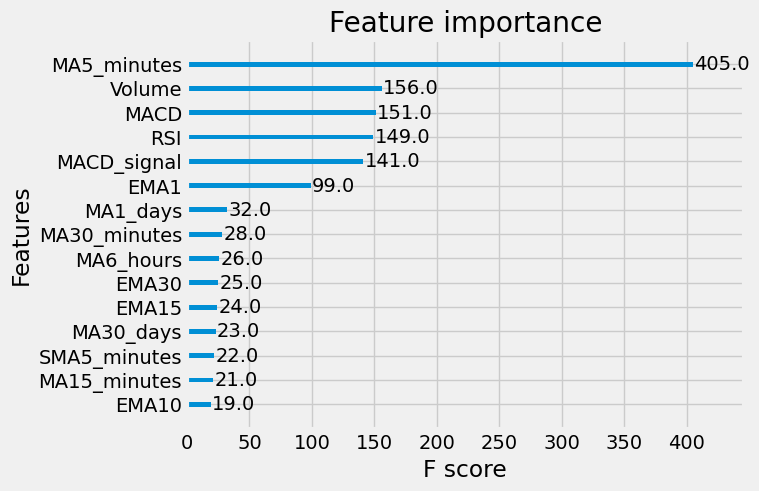

In [37]:
plot_importance(model,max_num_features=15)

In [38]:
y_pred = model.predict(X_test)
print(f'y_true = {np.array(y_test)[:5]}')
print(f'y_pred = {y_pred[:5]}')
print(f'mean_squared_error = {mean_squared_error(y_test, y_pred)}')

y_true = [50.1 50.1 50.  50.  50. ]
y_pred = [50.165394 50.17921  50.18769  50.130154 49.994614]
mean_squared_error = 6.9460856651392495


In [39]:
# prediction_plot(FPT_ticker, y_col='Fluctuation')
prediction_plot(FPT_ticker, y_col='Close')

* * *
# MSN

In [40]:
time_dict = {'minutes':[5, 15, 30], 'hours':[1, 6, 12], 'days':[1, 10, 15, 30]}
MSN_ticker = ticker_dict['MSN'].copy()
calc_MA(MSN_ticker, time_dict)
calc_SMA(MSN_ticker, time_dict)
calc_EMA(MSN_ticker, time_dict)
calc_RSI(MSN_ticker)
calc_MACD(MSN_ticker)
MSN_ticker.columns

Index(['Ticker', 'Open', 'High', 'Low', 'Close', 'Volume', 'Open Interest',
       'MA5_minutes', 'MA15_minutes', 'MA30_minutes', 'MA1_hours', 'MA6_hours',
       'MA12_hours', 'MA1_days', 'MA10_days', 'MA15_days', 'MA30_days',
       'SMA5_minutes', 'SMA15_minutes', 'SMA30_minutes', 'SMA1_hours',
       'SMA6_hours', 'SMA12_hours', 'SMA1_days', 'SMA10_days', 'SMA15_days',
       'SMA30_days', 'EMA1', 'EMA10', 'EMA15', 'EMA30', 'RSI', 'MACD',
       'MACD_signal'],
      dtype='object')

In [41]:
# MSN_ticker['Fluctuation'] = MSN_ticker['Fluctuation'].shift(-1)
MSN_ticker['Close'] = MSN_ticker['Close'].shift(-1)
# drop_cols = ['Close', 'Open', 'Low', 'High', 'Open Interest', 'Ticker']
MSN_ticker = drop(MSN_ticker,cols=['Open', 'Low', 'High', 'Open Interest', 'Ticker'], frows= 3300)
MSN_ticker = MSN_ticker[:-1]
MSN_ticker.columns

Index(['Close', 'Volume', 'MA5_minutes', 'MA15_minutes', 'MA30_minutes',
       'MA1_hours', 'MA6_hours', 'MA12_hours', 'MA1_days', 'MA10_days',
       'MA15_days', 'MA30_days', 'SMA5_minutes', 'SMA15_minutes',
       'SMA30_minutes', 'SMA1_hours', 'SMA6_hours', 'SMA12_hours', 'SMA1_days',
       'SMA10_days', 'SMA15_days', 'SMA30_days', 'EMA1', 'EMA10', 'EMA15',
       'EMA30', 'RSI', 'MACD', 'MACD_signal'],
      dtype='object')

In [ ]:
MSN_train, MSN_valid, MSN_test = train_test_split(MSN_ticker)
# plot_dataset(FPT_train, FPT_valid, FPT_test, col='Fluctuation')
plot_dataset(MSN_train, MSN_valid, MSN_test, col='Close')

In [44]:
# y_train, X_train, y_valid, X_valid, y_test, X_test = xy_split(MSN_train, MSN_valid, MSN_test, y_col='Fluctuation')
y_train, X_train, y_valid, X_valid, y_test, X_test = xy_split(MSN_train, MSN_valid, MSN_test, y_col='Close')

In [ ]:
%%time
eval_set = [(X_train, y_train), (X_valid, y_valid)]
xgboost = XGBRegressor(eval_set=eval_set, objective='reg:squarederror',
                       eval_metric=mean_squared_error, verbose=False)
clf = GridSearchCV(xgboost, parameters)
clf.fit(X_train, y_train,eval_set=eval_set)
print(f'Best params: {clf.best_params_}')
print(f'Best validation score = {clf.best_score_}')

In [46]:
%%time
model = XGBRegressor(**clf.best_params_, objective='reg:squarederror')
model.fit(X_train, y_train, eval_set=eval_set, verbose=False)

CPU times: user 3.63 s, sys: 12 ms, total: 3.64 s
Wall time: 1.9 s


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=20,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.001, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=1000000, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

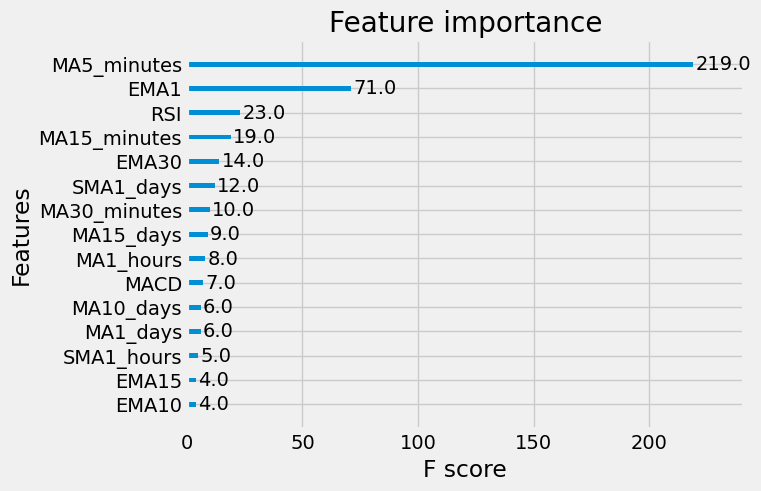

In [47]:
plot_importance(model,max_num_features=15)

In [48]:
y_pred = model.predict(X_test)
print(f'y_true = {np.array(y_test)[:5]}')
print(f'y_pred = {y_pred[:5]}')
print(f'mean_squared_error = {mean_squared_error(y_test, y_pred)}')

y_true = [53.66 53.66 53.66 53.66 53.56]
y_pred = [54.00572 54.00572 54.00572 54.00572 54.00572]
mean_squared_error = 0.43359496674850556


In [51]:
# prediction_plot(y_col='Fluctuation')
prediction_plot(MSN_ticker, y_col='Close')

* * *
# PNJ

In [52]:
time_dict = {'minutes':[5, 15, 30], 'hours':[1, 6, 12], 'days':[1, 10, 15, 30]}
PNJ_ticker = ticker_dict['PNJ'].copy()
calc_MA(PNJ_ticker, time_dict)
calc_SMA(PNJ_ticker, time_dict)
calc_EMA(PNJ_ticker, time_dict)
calc_RSI(PNJ_ticker)
calc_MACD(PNJ_ticker)
PNJ_ticker.columns

Index(['Ticker', 'Open', 'High', 'Low', 'Close', 'Volume', 'Open Interest',
       'MA5_minutes', 'MA15_minutes', 'MA30_minutes', 'MA1_hours', 'MA6_hours',
       'MA12_hours', 'MA1_days', 'MA10_days', 'MA15_days', 'MA30_days',
       'SMA5_minutes', 'SMA15_minutes', 'SMA30_minutes', 'SMA1_hours',
       'SMA6_hours', 'SMA12_hours', 'SMA1_days', 'SMA10_days', 'SMA15_days',
       'SMA30_days', 'EMA1', 'EMA10', 'EMA15', 'EMA30', 'RSI', 'MACD',
       'MACD_signal'],
      dtype='object')

In [53]:
# PNJ_ticker['Fluctuation'] = PNJ_ticker['Fluctuation'].shift(-1)
PNJ_ticker['Close'] = PNJ_ticker['Close'].shift(-1)
# drop_cols = ['Close', 'Open', 'Low', 'High', 'Open Interest', 'Ticker']
PNJ_ticker = drop(PNJ_ticker, cols=['Open', 'Low', 'High', 'Open Interest', 'Ticker'], frows=3300)
PNJ_ticker = PNJ_ticker[:-1]
PNJ_ticker.columns

Index(['Close', 'Volume', 'MA5_minutes', 'MA15_minutes', 'MA30_minutes',
       'MA1_hours', 'MA6_hours', 'MA12_hours', 'MA1_days', 'MA10_days',
       'MA15_days', 'MA30_days', 'SMA5_minutes', 'SMA15_minutes',
       'SMA30_minutes', 'SMA1_hours', 'SMA6_hours', 'SMA12_hours', 'SMA1_days',
       'SMA10_days', 'SMA15_days', 'SMA30_days', 'EMA1', 'EMA10', 'EMA15',
       'EMA30', 'RSI', 'MACD', 'MACD_signal'],
      dtype='object')

In [ ]:
PNJ_train, PNJ_valid, PNJ_test = train_test_split(PNJ_ticker)
# plot_dataset(FPT_train, FPT_valid, FPT_test, col='Fluctuation')
plot_dataset(PNJ_train, PNJ_valid, PNJ_test, col='Close')

In [55]:
# y_train, X_train, y_valid, X_valid, y_test, X_test = xy_split(FPT_train, FPT_valid, FPT_test, y_col='Fluctuation')
y_train, X_train, y_valid, X_valid, y_test, X_test = xy_split(PNJ_train, PNJ_valid, PNJ_test, y_col='Close')

In [ ]:
%%time
eval_set = [(X_train, y_train), (X_valid, y_valid)]
xgboost = XGBRegressor(eval_set=eval_set, objective='reg:squarederror',
                       eval_metric=mean_squared_error, verbose=False)
clf = GridSearchCV(xgboost, parameters)
clf.fit(X_train, y_train,eval_set=eval_set)
print(f'Best params: {clf.best_params_}')
print(f'Best validation score = {clf.best_score_}')

In [57]:
%%time
model = XGBRegressor(**clf.best_params_, objective='reg:squarederror')
model.fit(X_train, y_train, eval_set=eval_set, verbose=False)

CPU times: user 5.38 s, sys: 29.9 ms, total: 5.41 s
Wall time: 2.87 s


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=20,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.001, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=1000000, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

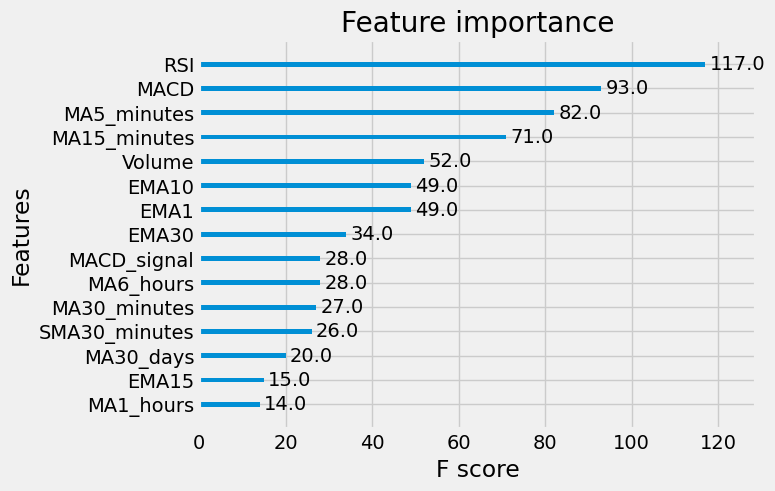

In [58]:
plot_importance(model,max_num_features=15)

In [59]:
y_pred = model.predict(X_test)
print(f'y_true = {np.array(y_test)[:5]}')
print(f'y_pred = {y_pred[:5]}')
print(f'mean_squared_error = {mean_squared_error(y_test, y_pred)}')

y_true = [55.38 55.38 55.38 55.38 55.18]
y_pred = [55.019524 55.033962 55.033962 55.033962 55.033962]
mean_squared_error = 0.08772694677778138


In [60]:
# prediction_plot(y_col='Fluctuation')
prediction_plot(PNJ_ticker, y_col='Close')



---


# VIC

In [61]:
time_dict = {'minutes':[5, 15, 30], 'hours':[1, 6, 12], 'days':[1, 10, 15, 30]}
VIC_ticker = ticker_dict['VIC'].copy()
calc_MA(VIC_ticker, time_dict)
calc_SMA(VIC_ticker, time_dict)
calc_EMA(VIC_ticker, time_dict)
calc_RSI(VIC_ticker)
calc_MACD(VIC_ticker)
VIC_ticker.columns

Index(['Ticker', 'Open', 'High', 'Low', 'Close', 'Volume', 'Open Interest',
       'MA5_minutes', 'MA15_minutes', 'MA30_minutes', 'MA1_hours', 'MA6_hours',
       'MA12_hours', 'MA1_days', 'MA10_days', 'MA15_days', 'MA30_days',
       'SMA5_minutes', 'SMA15_minutes', 'SMA30_minutes', 'SMA1_hours',
       'SMA6_hours', 'SMA12_hours', 'SMA1_days', 'SMA10_days', 'SMA15_days',
       'SMA30_days', 'EMA1', 'EMA10', 'EMA15', 'EMA30', 'RSI', 'MACD',
       'MACD_signal'],
      dtype='object')

In [63]:
# VIC_ticker['Fluctuation'] = VIC_ticker['Fluctuation'].shift(-1)
VIC_ticker['Close'] = VIC_ticker['Close'].shift(-1)
# drop_cols = ['Close', 'Open', 'Low', 'High', 'Open Interest', 'Ticker']
VIC_ticker = drop(VIC_ticker, cols=['Open', 'Low', 'High', 'Open Interest', 'Ticker'], frows=3300)
VIC_ticker = VIC_ticker[:-1]
VIC_ticker.columns

Index(['Close', 'Volume', 'MA5_minutes', 'MA15_minutes', 'MA30_minutes',
       'MA1_hours', 'MA6_hours', 'MA12_hours', 'MA1_days', 'MA10_days',
       'MA15_days', 'MA30_days', 'SMA5_minutes', 'SMA15_minutes',
       'SMA30_minutes', 'SMA1_hours', 'SMA6_hours', 'SMA12_hours', 'SMA1_days',
       'SMA10_days', 'SMA15_days', 'SMA30_days', 'EMA1', 'EMA10', 'EMA15',
       'EMA30', 'RSI', 'MACD', 'MACD_signal'],
      dtype='object')

In [ ]:
VIC_train, VIC_valid, VIC_test = train_test_split(VIC_ticker)
# plot_dataset(VIC_train, VIC_valid, VICtest, col='Fluctuation')
plot_dataset(VIC_train, VIC_valid, VIC_test, col='Close')

In [72]:
# y_train, X_train, y_valid, X_valid, y_test, X_test = xy_split(VIC_train, VIC_valid, VIC_test, y_col='Fluctuation')
y_train, X_train, y_valid, X_valid, y_test, X_test = xy_split(VIC_train, VIC_valid, VIC_test, y_col='Close')

In [ ]:
%%time
eval_set = [(X_train, y_train), (X_valid, y_valid)]
xgboost = XGBRegressor(eval_set=eval_set, objective='reg:squarederror',
                       eval_metric=mean_squared_error, verbose=False)
clf = GridSearchCV(xgboost, parameters)
clf.fit(X_train, y_train,eval_set=eval_set)
print(f'Best params: {clf.best_params_}')
print(f'Best validation score = {clf.best_score_}')

In [67]:
%%time
model = XGBRegressor(**clf.best_params_, objective='reg:squarederror')
model.fit(X_train, y_train, eval_set=eval_set, verbose=False)

CPU times: user 5.28 s, sys: 22.6 ms, total: 5.3 s
Wall time: 2.96 s


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=20,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.001, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=1000000, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

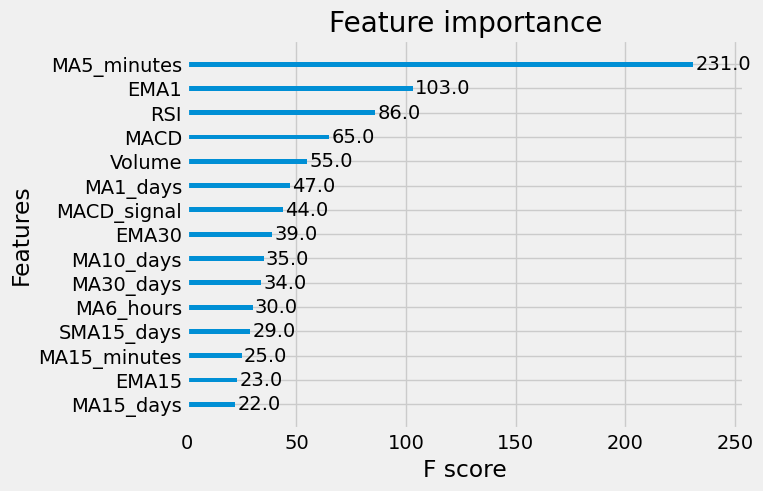

In [68]:
plot_importance(model,max_num_features=15)

In [71]:
# prediction_plot(y_col='Fluctuation')
prediction_plot(VIC_ticker, y_col='Close')